VAR MODEL

In [ ]:
import pandas as pd
import numpy as np
import datetime
import matplotlib.pyplot as plt
%matplotlib inline
from statsmodels.tsa.api import VAR
from statsmodels.tsa.stattools import adfuller
from statsmodels.tools.eval_measures import rmse, aic

/usr/local/lib/python3.7/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


Importing Data Frame/Set

In [ ]:
df = pd.read_csv('/content/Solcast_Data.csv')

In [ ]:
df['Date'] = pd.to_datetime(df[["Year", "Month", "Day", "Hour", "Minute"]])
DF = df.set_index('Date')
DF

,Year,Month,Day,Hour,Minute,Tamb,Albedo,Azimuth,Cloudopacity,DewPoint,DHI,DNI,EBH,GHI,GtiFixedTilt,GtiTracking,Pw,Pressure,SnowDepth,WindDir,WindVel,Zenith
Date,,,,,,,,,,,,,,,,,,,,,,
2018-01-01 00:00:00,2018,1,1,0,0,17.5,0.15,-142,0.0,13.6,0,0,0,0,0,0,1.88,922.3,0,88,2.0,166
2018-01-01 01:00:00,2018,1,1,1,0,16.8,0.15,-118,0.0,13.9,0,0,0,0,0,0,1.87,921.9,0,84,2.0,154
2018-01-01 02:00:00,2018,1,1,2,0,16.7,0.15,-111,0.0,14.3,0,0,0,0,0,0,1.86,921.7,0,83,1.9,141
2018-01-01 03:00:00,2018,1,1,3,0,17.3,0.15,-109,0.0,15.0,0,0,0,0,0,0,1.84,921.6,0,85,1.7,127
2018-01-01 04:00:00,2018,1,1,4,0,17.8,0.15,-110,0.0,15.7,0,0,0,0,0,0,1.83,921.6,0,88,1.5,114
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-01-01 19:00:00,2020,1,1,19,0,21.8,0.15,110,0.0,17.5,0,0,0,0,0,0,3.30,918.4,0,95,4.0,117
2020-01-01 20:00:00,2020,1,1,20,0,21.0,0.15,110,0.0,17.7,0,0,0,0,0,0,3.36,919.1,0,92,4.7,131
2020-01-01 21:00:00,2020,1,1,21,0,20.4,0.15,112,0.0,17.7,0,0,0,0,0,0,3.45,919.5,0,92,5.0,145


Dopping the data not required and hard code munging of data done

In [ ]:
DF.drop(['Year',	'Month',	'Day',	'Hour',	'Minute', 'SnowDepth'], axis=1,inplace=True)
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
pd.set_option('display.width', None)
pd.set_option('display.max_colwidth', -1)
DF


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: FutureWarning: Passing a negative integer is deprecated in version 1.0 and will not be supported in future version. Instead, use None to not limit the column width.
  """


,Tamb,Albedo,Azimuth,Cloudopacity,DewPoint,DHI,DNI,EBH,GHI,GtiFixedTilt,GtiTracking,Pw,Pressure,WindDir,WindVel,Zenith
Date,,,,,,,,,,,,,,,,
2018-01-01 00:00:00,17.5,0.15,-142,0.0,13.6,0,0,0,0,0,0,1.88,922.3,88,2.0,166
2018-01-01 01:00:00,16.8,0.15,-118,0.0,13.9,0,0,0,0,0,0,1.87,921.9,84,2.0,154
2018-01-01 02:00:00,16.7,0.15,-111,0.0,14.3,0,0,0,0,0,0,1.86,921.7,83,1.9,141
2018-01-01 03:00:00,17.3,0.15,-109,0.0,15.0,0,0,0,0,0,0,1.84,921.6,85,1.7,127
2018-01-01 04:00:00,17.8,0.15,-110,0.0,15.7,0,0,0,0,0,0,1.83,921.6,88,1.5,114
2018-01-01 05:00:00,18.4,0.15,-112,0.0,15.8,0,0,0,0,0,0,1.81,922.0,90,1.3,100
2018-01-01 06:00:00,19.0,0.15,-115,17.1,15.5,27,3,0,27,27,27,1.79,922.7,90,1.0,87
2018-01-01 07:00:00,19.6,0.15,-119,28.1,15.2,146,82,28,175,185,231,1.77,923.4,90,0.7,74
2018-01-01 08:00:00,20.9,0.15,-126,3.8,14.6,123,649,321,444,521,718,1.75,923.7,85,0.6,61


Visualising all the variables to get familiar with the trend

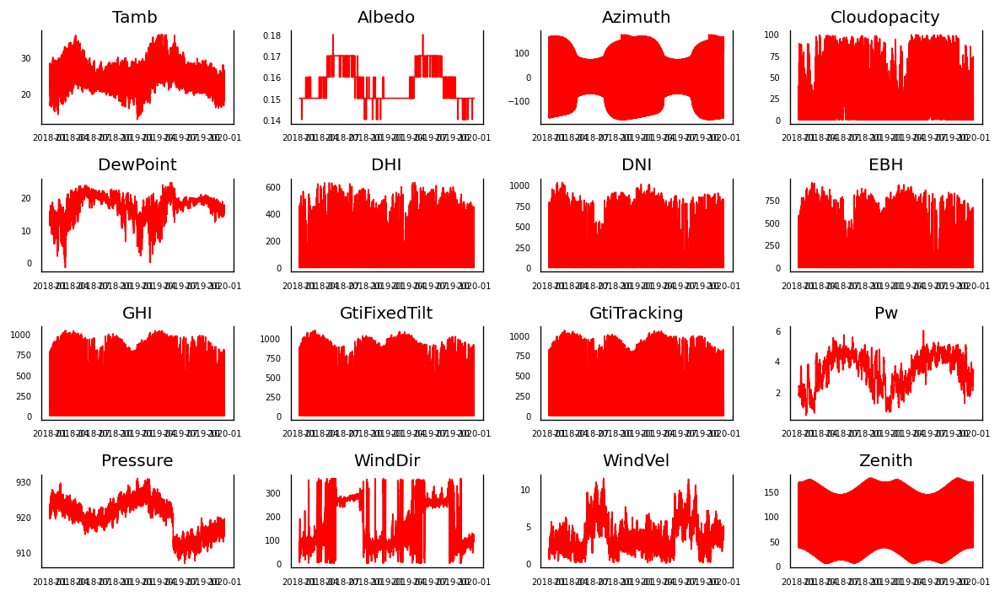

In [ ]:
fig, axes = plt.subplots(nrows=4, ncols=4, dpi=120, figsize=(10,6))
for i, ax in enumerate(axes.flatten()):
    data = DF[DF.columns[i]]
    ax.plot(data, color='red', linewidth=1)
    # Decorations
    ax.set_title(DF.columns[i])
    ax.xaxis.set_ticks_position('none')
    ax.yaxis.set_ticks_position('none')
    ax.spines["top"].set_alpha(0)
    ax.tick_params(labelsize=6)

plt.tight_layout();

Granger Causality test is done for determining interrelation between data points

In [ ]:
from statsmodels.tsa.stattools import grangercausalitytests
maxlag=12
test = 'ssr_chi2test'
def grangers_causation_matrix(data, variables, test='ssr_chi2test', verbose=False):
    df = pd.DataFrame(np.zeros((len(variables), len(variables))), columns=variables, index=variables)
    for c in df.columns:
        for r in df.index:
            test_result = grangercausalitytests(data[[r, c]], maxlag=maxlag, verbose=False)
            p_values = [round(test_result[i+1][0][test][1],4) for i in range(maxlag)]
            if verbose: print(f'Y = {r}, X = {c}, P Values = {p_values}')
            min_p_value = np.min(p_values)
            df.loc[r, c] = min_p_value
    df.columns = [var + '_x' for var in variables]
    df.index = [var + '_y' for var in variables]
    return df


grangers_causation_matrix(DF, variables = DF.columns)

,Tamb _x,Albedo_x,Azimuth_x,Cloudopacity_x,DewPoint_x,DHI_x,DNI_x,EBH_x,GHI_x,GtiFixedTilt_x,GtiTracking_x,Pw_x,Pressure_x,WindDir_x,WindVel_x,Zenith_x
Tamb _y,1.000,0.000,0.0000,0.0000,0.0,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0,0.0000,0.0,0.0000,0.0
Albedo_y,0.128,1.000,0.9611,0.0044,0.0,0.5753,0.2053,0.3356,0.6686,0.5369,0.5307,0.0,0.0011,0.0,0.0064,0.0
Azimuth_y,0.000,0.858,1.0000,0.0000,0.0,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0,0.0000,0.0,0.0000,0.0
Cloudopacity_y,0.000,0.000,0.0000,1.0000,0.0,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0,0.0000,0.0,0.0000,0.0
DewPoint_y,0.000,0.000,0.0000,0.0000,1.0,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0,0.0000,0.0,0.0000,0.0
DHI_y,0.000,0.000,0.0000,0.0000,0.0,1.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.0,0.0000,0.0,0.0000,0.0
DNI_y,0.000,0.000,0.0000,0.0000,0.0,0.0000,1.0000,0.0000,0.0000,0.0000,0.0000,0.0,0.0000,0.0,0.0000,0.0
EBH_y,0.000,0.000,0.0000,0.0000,0.0,0.0000,0.0000,1.0000,0.0000,0.0000,0.0000,0.0,0.0000,0.0,0.0000,0.0
GHI_y,0.000,0.000,0.0000,0.0000,0.0,0.0000,0.0000,0.0000,1.0000,0.0000,0.0000,0.0,0.0000,0.0,0.0000,0.0
GtiFixedTilt_y,0.000,0.000,0.0000,0.0000,0.0,0.0000,0.0000,0.0000,0.0000,1.0000,0.0000,0.0,0.0000,0.0,0.0000,0.0


In [ ]:
from statsmodels.tsa.vector_ar.vecm import coint_johansen

def cointegration_test(df):
    """Perform Johanson's Cointegration Test and Report Summary"""
    out = coint_johansen(df.astype(float),-1,5)
    d = {'0.90':0, '0.95':1, '0.99':2}
    traces = out.lr1
    alpha=0.05
    cvts = out.cvt[:, d[str(1-alpha)]]
    def adjust(val, length= 6): return str(val).ljust(length)

    # Summary
    print('Name   ::  Test Stat > C(95%)   =>   Signif  \n', '--'*40)
    for col, trace, cvt in zip(DF.columns, traces, cvts):
        print(adjust(col), ':: ', adjust(round(trace,2), 9), ">", adjust(cvt, 8), ' =>  ' , trace > cvt)

cointegration_test(DF)

/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/vector_ar/vecm.py:608: HypothesisTestWarning: Critical values are only available for time series with 12 variables at most.
  category=HypothesisTestWarning)


Name   ::  Test Stat > C(95%)   =>   Signif  
 --------------------------------------------------------------------------------
Tamb   ::  32342.69  > nan       =>   False
Albedo ::  23355.47  > nan       =>   False
Azimuth ::  19230.88  > nan       =>   False
Cloudopacity ::  15676.14  > nan       =>   False
DewPoint ::  12543.68  > 311.1288  =>   True
DHI    ::  9619.85   > 263.2603  =>   True
DNI    ::  6931.46   > 219.4051  =>   True
EBH    ::  4977.03   > 179.5199  =>   True
GHI    ::  3403.36   > 143.6691  =>   True
GtiFixedTilt ::  2070.47   > 111.7797  =>   True
GtiTracking ::  1275.72   > 83.9383   =>   True
Pw     ::  750.08    > 60.0627   =>   True
Pressure ::  342.55    > 40.1749   =>   True
WindDir ::  161.47    > 24.2761   =>   True
WindVel ::  29.37     > 12.3212   =>   True
Zenith ::  0.02      > 4.1296    =>   False


Shape is determined to check for the number of data points in the set

In [ ]:
DF.shape

(17544, 16)

Manual segration of training and test set is done as per the literature survey and requirement

In [ ]:
nobs = 44
DF_train, DF_test = DF[0:-nobs], DF[-nobs:]
print(DF_train.shape)
print(DF_test.shape)

(17500, 16)
(44, 16)


Training set data is plot to re-observe the data after the splitting



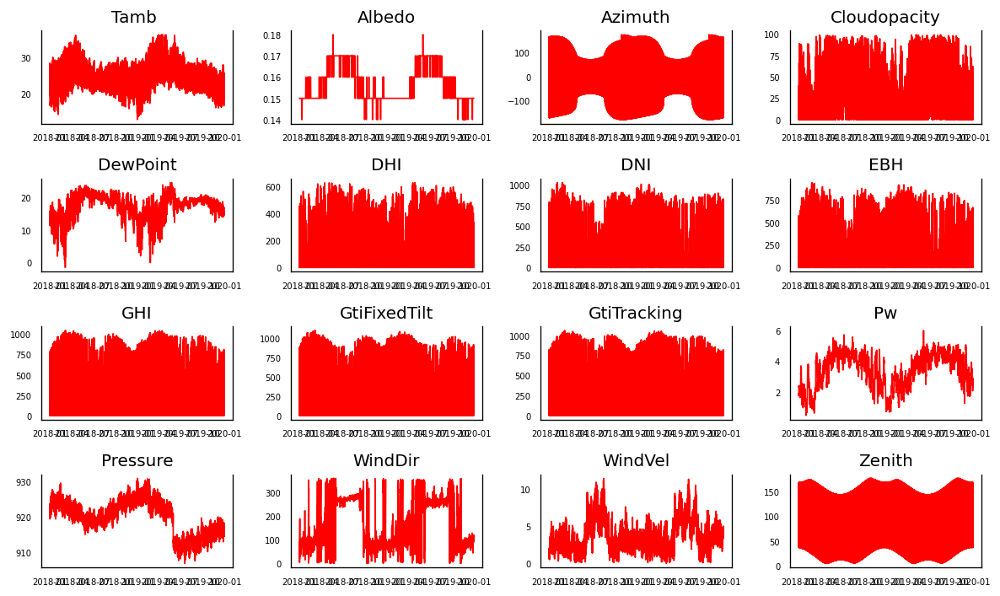

In [ ]:
fig, axes = plt.subplots(nrows=4, ncols=4, dpi=120, figsize=(10,6))
for i, ax in enumerate(axes.flatten()):
    data = DF_train[DF_train.columns[i]]
    ax.plot(data, color='red', linewidth=1)
    # Decorations
    ax.set_title(DF_train.columns[i])
    ax.xaxis.set_ticks_position('none')
    ax.yaxis.set_ticks_position('none')
    ax.spines["top"].set_alpha(0)
    ax.tick_params(labelsize=6)

plt.tight_layout();

Trend plot is determined to check for the changes in trend after splitting


In [ ]:
fig, axes = plt.subplots(nrows=4, ncols=4, dpi=1000, figsize=(10,15))
for i, ax in enumerate(axes.flatten()):
    data = DF_test[DF_test.columns[i]]
    ax.plot(data, color='red', linewidth=1)
    # Decorations
    ax.set_title(DF_test.columns[i])
    ax.xaxis.set_ticks_position('none')
    ax.yaxis.set_ticks_position('none')
    ax.spines["top"].set_alpha(0)
    ax.tick_params(labelsize=6)

plt.tight_layout();

Adfuller test code for checking if the data/variable is stationary.

In [ ]:
def adfuller_test(series, signif=0.05, name='', verbose=False):
    """Perform ADFuller to test for Stationarity of given series and print report"""
    r = adfuller(series, autolag='AIC')
    output = {'test_statistic':round(r[0], 4), 'pvalue':round(r[1], 4), 'n_lags':round(r[2], 4), 'n_obs':r[3]}
    p_value = output['pvalue']
    def adjust(val, length= 6): return str(val).ljust(length)

    # Print Summary
    print(f'    Augmented Dickey-Fuller Test on "{name}"', "\n   ", '-'*47)
    print(f' Null Hypothesis: Data has unit root. Non-Stationary.')
    print(f' Significance Level    = {signif}')
    print(f' Test Statistic        = {output["test_statistic"]}')
    print(f' No. Lags Chosen       = {output["n_lags"]}')

    for key,val in r[4].items():
        print(f' Critical value {adjust(key)} = {round(val, 3)}')

    if p_value <= signif:
        print(f" => P-Value = {p_value}. Rejecting Null Hypothesis.")
        print(f" => Series is Stationary.")
    else:
        print(f" => P-Value = {p_value}. Weak evidence to reject the Null Hypothesis.")
        print(f" => Series is Non-Stationary.")

Analysis of ADF test after first iteration

In [ ]:
# ADF Test on each column
for name, column in DF_train.iteritems():
    adfuller_test(column.astype(float), name=column.name)
    print('\n')

    Augmented Dickey-Fuller Test on "Tamb " 
    -----------------------------------------------
 Null Hypothesis: Data has unit root. Non-Stationary.
 Significance Level    = 0.05
 Test Statistic        = -3.4226
 No. Lags Chosen       = 44
 Critical value 1%     = -3.431
 Critical value 5%     = -2.862
 Critical value 10%    = -2.567
 => P-Value = 0.0102. Rejecting Null Hypothesis.
 => Series is Stationary.


    Augmented Dickey-Fuller Test on "Albedo" 
    -----------------------------------------------
 Null Hypothesis: Data has unit root. Non-Stationary.
 Significance Level    = 0.05
 Test Statistic        = -5.1822
 No. Lags Chosen       = 24
 Critical value 1%     = -3.431
 Critical value 5%     = -2.862
 Critical value 10%    = -2.567
 => P-Value = 0.0. Rejecting Null Hypothesis.
 => Series is Stationary.


    Augmented Dickey-Fuller Test on "Azimuth" 
    -----------------------------------------------
 Null Hypothesis: Data has unit root. Non-Stationary.
 Significance Level

Since some data points were not stationary, redundant data is spotted and dropped

In [ ]:
DF_train_diff =DF_train.astype(float).diff().dropna()

ADF test taken again for rechecking if the data is now stationary

In [ ]:
for name, column in DF_train_diff.iteritems():
    adfuller_test(column, name=column.name)
    print('\n')

    Augmented Dickey-Fuller Test on "Tamb " 
    -----------------------------------------------
 Null Hypothesis: Data has unit root. Non-Stationary.
 Significance Level    = 0.05
 Test Statistic        = -30.076
 No. Lags Chosen       = 44
 Critical value 1%     = -3.431
 Critical value 5%     = -2.862
 Critical value 10%    = -2.567
 => P-Value = 0.0. Rejecting Null Hypothesis.
 => Series is Stationary.


    Augmented Dickey-Fuller Test on "Albedo" 
    -----------------------------------------------
 Null Hypothesis: Data has unit root. Non-Stationary.
 Significance Level    = 0.05
 Test Statistic        = -44.9408
 No. Lags Chosen       = 23
 Critical value 1%     = -3.431
 Critical value 5%     = -2.862
 Critical value 10%    = -2.567
 => P-Value = 0.0. Rejecting Null Hypothesis.
 => Series is Stationary.


    Augmented Dickey-Fuller Test on "Azimuth" 
    -----------------------------------------------
 Null Hypothesis: Data has unit root. Non-Stationary.
 Significance Level  

Min AIC value for oder of difference is determined and VAR model is trained on that value

In [ ]:
model = VAR(DF_train_diff)
x = model.select_order(maxlags=70)
x.summary()

/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning: No frequency information was provided, so inferred frequency H will be used.
  % freq, ValueWarning)


,AIC,BIC,FPE,HQIC
0,34.02,34.03,5.940e+14,34.02
1,24.41,24.53,3.978e+10,24.45
2,21.44,21.67,2.040e+09,21.51
3,20.40,20.75,7.219e+08,20.51
4,19.46,19.93,2.836e+08,19.62
5,18.73,19.31,1.367e+08,18.92
6,18.18,18.88,7.894e+07,18.41
7,17.72,18.52,4.957e+07,17.98
8,17.29,18.21,3.218e+07,17.59
9,16.99,18.03,2.397e+07,17.33


Detailed analysis of AIC value for each lag order

In [ ]:
model = VAR(DF_train_diff)
for i in range(1,70):
    result = model.fit(i)
    print('Lag Order =', i)
    print('AIC : ', result.aic)
    print('BIC : ', result.bic)
    print('FPE : ', result.fpe)
    print('HQIC: ', result.hqic, '\n')

/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/base/tsa_model.py:165: ValueWarning: No frequency information was provided, so inferred frequency H will be used.
  % freq, ValueWarning)


Lag Order = 1
AIC :  24.40212511890954
BIC :  24.522904464435044
FPE :  39601194888.005455
HQIC:  24.441897627341966 

Lag Order = 2
AIC :  21.433956916975717
BIC :  21.668422615689117
FPE :  2035397540.8623905
HQIC:  21.511166433966373 

Lag Order = 3
AIC :  20.39645715852547
BIC :  20.744620533519043
FPE :  721221884.0991548
HQIC:  20.51110762116222 

Lag Order = 4
AIC :  19.460923432774525
BIC :  19.922795808938794
FPE :  282990526.5132396
HQIC:  19.613018778788 

Lag Order = 5
AIC :  18.731763495053933
BIC :  19.307356199078043
FPE :  136490360.88566333
HQIC:  18.92130766281765 

Lag Order = 6
AIC :  18.183256656099346
BIC :  18.872581016471475
FPE :  78865819.1661125
HQIC:  18.410253584629878 

Lag Order = 7
AIC :  17.717284940858406
BIC :  18.520352287866142
FPE :  49490328.10573533
HQIC:  17.981738569815505 

Lag Order = 8
AIC :  17.283956653241535
BIC :  18.200778318972265
FPE :  32086981.095877007
HQIC:  17.58587092292828 

Lag Order = 9
AIC :  16.98839771566126
BIC :  18.0189

Determination of the least AIC value for the best order

In [ ]:
### FIND BEST VAR ORDER ###

AIC = {}
best_aic, best_order = np.inf, 0

for i in range(1,70):
    model = VAR(endog=DF_train_diff.values)
    model_result = model.fit(maxlags=i)
    AIC[i] = model_result.aic

    if AIC[i] < best_aic:
        best_aic = AIC[i]
        best_order = i

print('BEST ORDER', best_order, 'BEST AIC:', best_aic)

BEST ORDER 50 BEST AIC: 5.732205540911365


For better analysis AIC values are plotted against there order

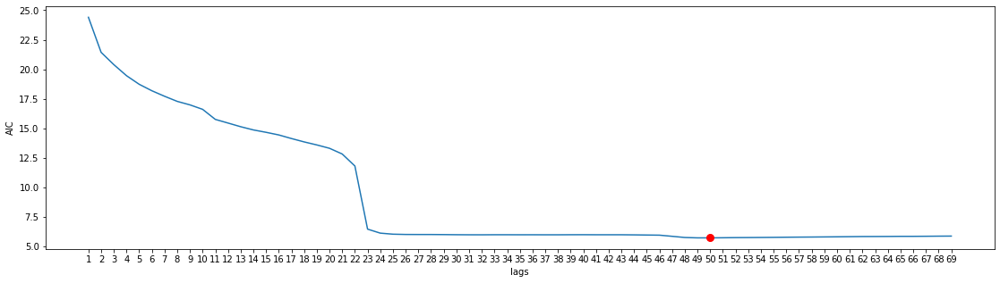

In [ ]:

### PLOT AICs ###

plt.figure(figsize=(19,5))
plt.plot(range(len(AIC)), list(AIC.values()))
plt.plot([best_order-1], [best_aic], marker='o', markersize=8, color="red")
plt.xticks(range(len(AIC)), range(1,70))
plt.xlabel('lags'); plt.ylabel('AIC')
np.set_printoptions(False)

Model is fitted on the best order determined by checking for the least AIC value

In [ ]:
model_fitted = model.fit(50)
model_fitted.summary()

  Summary of Regression Results   
Model:                         VAR
Method:                        OLS
Date:           Thu, 29, Jul, 2021
Time:                     10:05:16
--------------------------------------------------------------------
No. of Equations:         16.0000    BIC:                    11.4370
Nobs:                     17449.0    HQIC:                   7.61103
Log likelihood:          -433340.    FPE:                    308.968
AIC:                      5.73221    Det(Omega_mle):         150.673
--------------------------------------------------------------------
Results for equation y1
             coefficient       std. error           t-stat            prob
--------------------------------------------------------------------------
const          -0.000104         0.001256           -0.083           0.934
L1.y1           1.044492         0.007905          132.130           0.000
L1.y2          -1.073885         1.409131           -0.762           0.446
L1.y3       

After the differencing, Durbin Watson test is done to recheck for the autocorrelation at lag 1 in the residuals (prediction errors) from a regression analysis

In [ ]:
from statsmodels.stats.stattools import durbin_watson
out = durbin_watson(model_fitted.resid)
def adjust(val, length= 6): return str(val).ljust(length)

for col, val in zip(DF_train.columns, out):
    print(adjust(col), ':', round(val, 2))

Tamb   : 2.0
Albedo : 2.0
Azimuth : 2.0
Cloudopacity : 2.0
DewPoint : 2.0
DHI    : 2.0
DNI    : 2.0
EBH    : 2.0
GHI    : 2.0
GtiFixedTilt : 2.0
GtiTracking : 2.0
Pw     : 2.0
Pressure : 2.0
WindDir : 2.0
WindVel : 2.0
Zenith : 2.0


Analysis of the fitted model is observed in the form of an array of data

In [ ]:
# Get the lag order
lag_order = model_fitted.k_ar
print(lag_order)  #> 4

# Input data for forecasting
forecast_input = DF_train_diff.values[-lag_order:]
forecast_input

50


array([[-3.e-01,  0.e+00,  7.e+00,  0.e+00, -2.e-01,  0.e+00,  0.e+00,
         0.e+00,  0.e+00,  0.e+00,  0.e+00,  0.e+00, -2.e-01, -1.e+00,
        -3.e-01, -1.e+01],
       [-3.e-01,  0.e+00,  1.e+00,  0.e+00, -3.e-01,  0.e+00,  0.e+00,
         0.e+00,  0.e+00,  0.e+00,  0.e+00, -5.e-02, -1.e-01,  2.e+00,
         0.e+00, -1.e+01],
       [-1.e-01,  0.e+00,  0.e+00,  0.e+00,  2.e-01,  0.e+00,  0.e+00,
         0.e+00,  0.e+00,  0.e+00,  0.e+00,  1.e-02,  1.e-01,  2.e+00,
        -2.e-01, -1.e+01],
       [ 0.e+00,  0.e+00, -2.e+00,  0.e+00,  2.e-01,  0.e+00,  0.e+00,
         0.e+00,  0.e+00,  0.e+00,  0.e+00,  3.e-02,  4.e-01, -5.e+00,
        -3.e-01, -1.e+01],
       [ 2.e-01,  0.e+00, -3.e+00,  8.e+00,  0.e+00,  3.e+01,  4.e+00,
         1.e+00,  3.e+01,  3.e+01,  3.e+01, -3.e-02,  6.e-01, -5.e+00,
         3.e-01, -1.e+01],
       [ 9.e-01,  0.e+00, -5.e+00,  3.e+00,  0.e+00,  1.e+02,  2.e+02,
         6.e+01,  2.e+02,  2.e+02,  3.e+02, -3.e-02,  6.e-01,  0.e+00,
         4.e-

Forecast on test set is done, but is in inverse form because of the mathematical constrains of the model.

In [ ]:
# Forecast
fc = model_fitted.forecast(y=forecast_input, steps=nobs)
df_forecast = pd.DataFrame(fc, index=DF_test.index[-nobs:], columns = DF_train.columns + '_1d')
df_forecast

,Tamb _1d,Albedo_1d,Azimuth_1d,Cloudopacity_1d,DewPoint_1d,DHI_1d,DNI_1d,EBH_1d,GHI_1d,GtiFixedTilt_1d,GtiTracking_1d,Pw_1d,Pressure_1d,WindDir_1d,WindVel_1d,Zenith_1d
Date,,,,,,,,,,,,,,,,
2019-12-31 04:00:00,0.256269,-0.000094,-2.113286,2.096774,0.097956,-2.218298,-3.411639,9.115951,6.676645,5.520523,-3.576786,0.056058,0.425064,-4.610892,-0.207961,-13.785183
2019-12-31 05:00:00,0.233901,0.000274,1.138500,0.873555,0.126277,10.196323,17.936536,-1.075957,9.322549,10.425724,22.576331,0.067202,0.621453,-13.077424,-0.035863,-13.194860
2019-12-31 06:00:00,0.310813,0.000183,-3.283548,18.274122,-0.083131,27.932139,-19.304182,-14.270032,13.684493,13.528065,4.600097,0.001839,0.692215,9.578174,0.140342,-13.914620
2019-12-31 07:00:00,0.690586,0.000212,-6.212553,4.006472,-0.011799,74.941648,123.456990,49.116884,123.955446,143.790410,190.026222,-0.019439,0.618258,3.501798,0.269267,-13.021054
2019-12-31 08:00:00,1.339886,0.000068,-4.870707,-12.155057,-0.126053,54.533457,279.866938,156.350980,210.831727,246.869311,314.895930,0.000318,0.490404,0.329810,0.335968,-11.969009
2019-12-31 09:00:00,1.667407,-0.000021,-10.797107,-9.117866,-0.301456,37.554671,180.136029,172.421970,210.105648,231.616905,168.365231,0.005650,0.183217,5.326188,0.303762,-11.216343
2019-12-31 10:00:00,1.569152,-0.000076,-14.574505,-1.829099,-0.293991,27.704549,46.342185,102.949608,130.617004,134.823418,49.896644,0.003086,-0.258513,7.919517,-0.045232,-8.767514
2019-12-31 11:00:00,1.097503,-0.000013,-21.226062,10.743501,-0.201663,20.709934,-54.976381,-14.786052,5.949166,3.767151,-36.170649,0.004906,-0.691612,-9.054878,-0.064350,-4.187133
2019-12-31 12:00:00,0.623607,-0.000111,337.380211,3.576199,-0.128030,46.477007,-97.491045,-80.846353,-34.421269,-45.417837,-33.541871,0.005322,-0.994294,5.658305,0.046406,1.067127


Inverse form the matrix/array seen above is done using this function

In [ ]:
def invert_transformation(df_train, df_forecast, second_diff=False):
    """Revert back the differencing to get the forecast to original scale."""
    df_fc = df_forecast.copy()
    columns = df_train.columns
    for col in columns:
        # Roll back 2nd Diff
        if second_diff:
            df_fc[str(col)+'_1d'] = (df_train[col].iloc[-1]-df_train[col].iloc[-2]) + df_fc[str(col)+'_2d'].cumsum()
        # Roll back 1st Diff
        df_fc[str(col)+'_forecast'] = df_train[col].iloc[-1] + df_fc[str(col)+'_1d'].cumsum()
    return df_fc


In [ ]:
df_results = invert_transformation(DF_test.astype(float), df_forecast.astype(float), second_diff=False)
df_r = df_results.loc[:, ['Tamb _forecast',	'Albedo_forecast',	'Azimuth_forecast',	'Cloudopacity_forecast',	'DewPoint_forecast',	'DHI_forecast',	'DNI_forecast',	'EBH_forecast',	'GHI_forecast',	'GtiFixedTilt_forecast',	'GtiTracking_forecast',	'Pw_forecast',	'Pressure_forecast',	'WindDir_forecast',	'WindVel_forecast',	'Zenith_forecast']]

Actual predicted data on test set in tabular form

In [ ]:
df_r

,Tamb _forecast,Albedo_forecast,Azimuth_forecast,Cloudopacity_forecast,DewPoint_forecast,DHI_forecast,DNI_forecast,EBH_forecast,GHI_forecast,GtiFixedTilt_forecast,GtiTracking_forecast,Pw_forecast,Pressure_forecast,WindDir_forecast,WindVel_forecast,Zenith_forecast
Date,,,,,,,,,,,,,,,,
2019-12-31 04:00:00,19.756269,0.149906,153.886714,2.096774,17.697956,-2.218298,-3.411639,9.115951,6.676645,5.520523,-3.576786,3.256058,919.525064,95.389108,3.792039,154.214817
2019-12-31 05:00:00,19.990170,0.150179,155.025214,2.970329,17.824234,7.978025,14.524898,8.039995,15.999194,15.946247,18.999545,3.323260,920.146517,82.311685,3.756176,141.019956
2019-12-31 06:00:00,20.300983,0.150363,151.741665,21.244451,17.741102,35.910163,-4.779285,-6.230038,29.683687,29.474312,23.599642,3.325100,920.838732,91.889858,3.896519,127.105337
2019-12-31 07:00:00,20.991569,0.150575,145.529112,25.250923,17.729303,110.851812,118.677706,42.886846,153.639134,173.264722,213.625865,3.305661,921.456990,95.391656,4.165786,114.084283
2019-12-31 08:00:00,22.331455,0.150642,140.658405,13.095866,17.603250,165.385268,398.544644,199.237826,364.470860,420.134033,528.521795,3.305979,921.947394,95.721466,4.501754,102.115273
2019-12-31 09:00:00,23.998862,0.150622,129.861299,3.978000,17.301794,202.939939,578.680673,371.659796,574.576508,651.750938,696.887026,3.311629,922.130611,101.047654,4.805516,90.898931
2019-12-31 10:00:00,25.568014,0.150546,115.286794,2.148901,17.007803,230.644488,625.022858,474.609404,705.193512,786.574355,746.783670,3.314715,921.872098,108.967171,4.760283,82.131417
2019-12-31 11:00:00,26.665517,0.150532,94.060733,12.892402,16.806140,251.354423,570.046478,459.823352,711.142678,790.341506,710.613021,3.319622,921.180486,99.912293,4.695933,77.944283
2019-12-31 12:00:00,27.289123,0.150421,431.440943,16.468601,16.678110,297.831429,472.555432,378.976999,676.721409,744.923669,677.071150,3.324944,920.186192,105.570599,4.742339,79.011410


Plot of the test set against the predicted value

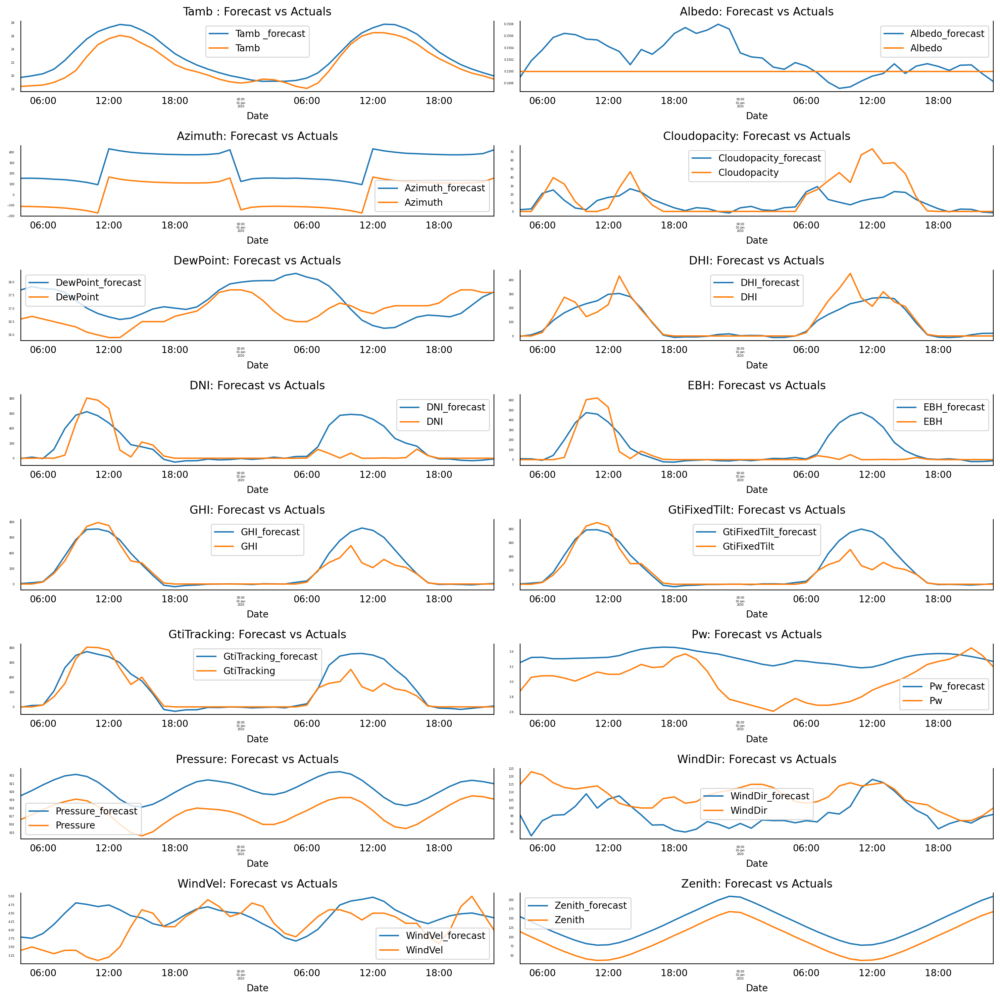

In [ ]:
fig, axes = plt.subplots(nrows=8, ncols=2, dpi=200, figsize=(15,15))
for i, (col,ax) in enumerate(zip(DF_test.columns, axes.flatten())):
    df_r[col+'_forecast'].plot(legend=True, ax=ax).autoscale(axis='x',tight=True)
    DF_test[col][-nobs:].plot(legend=True, ax=ax);
    ax.set_title(col + ": Forecast vs Actuals")
    ax.xaxis.set_ticks_position('none')
    ax.yaxis.set_ticks_position('none')
    ax.spines["top"].set_alpha(0)
    ax.tick_params(labelsize=3)

plt.tight_layout();


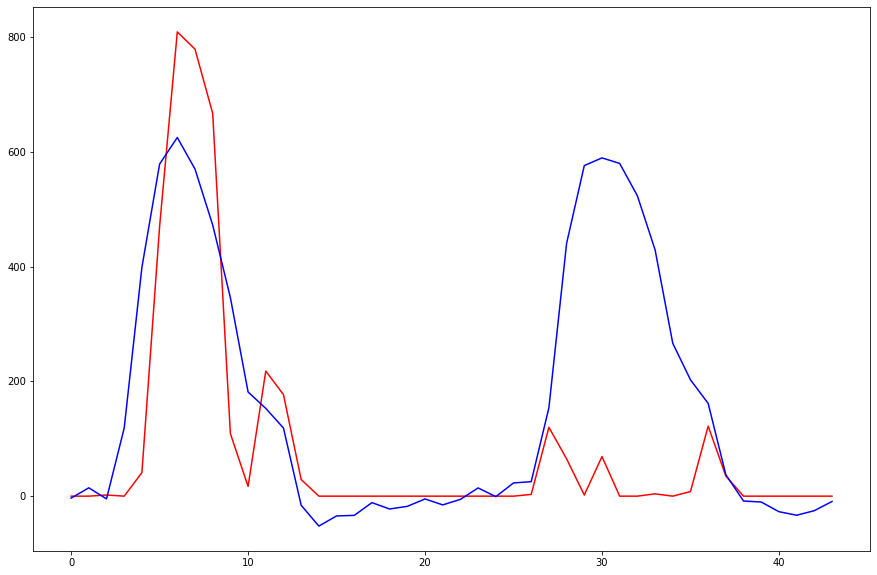

In [ ]:
plt.rcParams["figure.figsize"] = (15,10)
plt.plot(DF_test["DNI"].astype(float).tolist(), 'r')
plt.plot(df_r["DNI_forecast"].astype(float).tolist(), 'b')

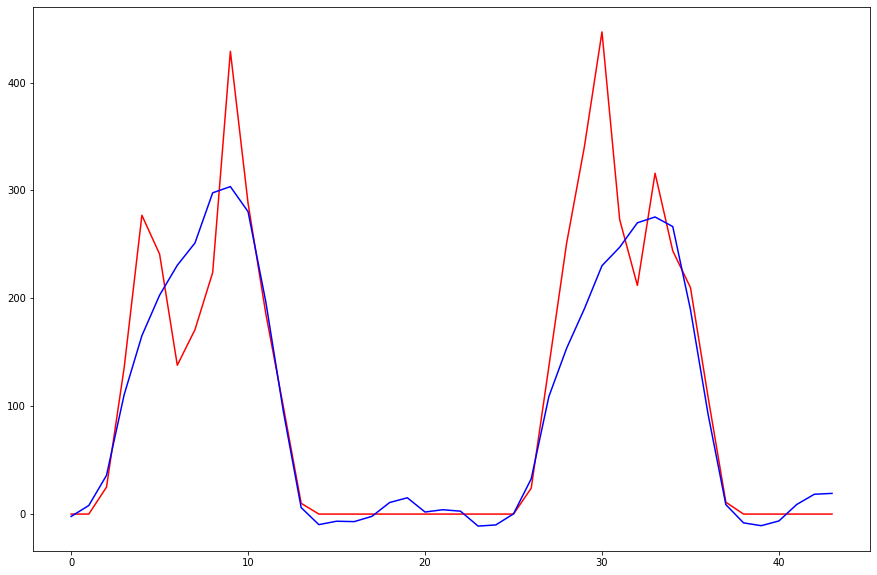

In [ ]:
plt.rcParams["figure.figsize"] = (15,10)
plt.plot(DF_test["DHI"].astype(float).tolist(), 'r')
plt.plot(df_r["DHI_forecast"].astype(float).tolist(), 'b')

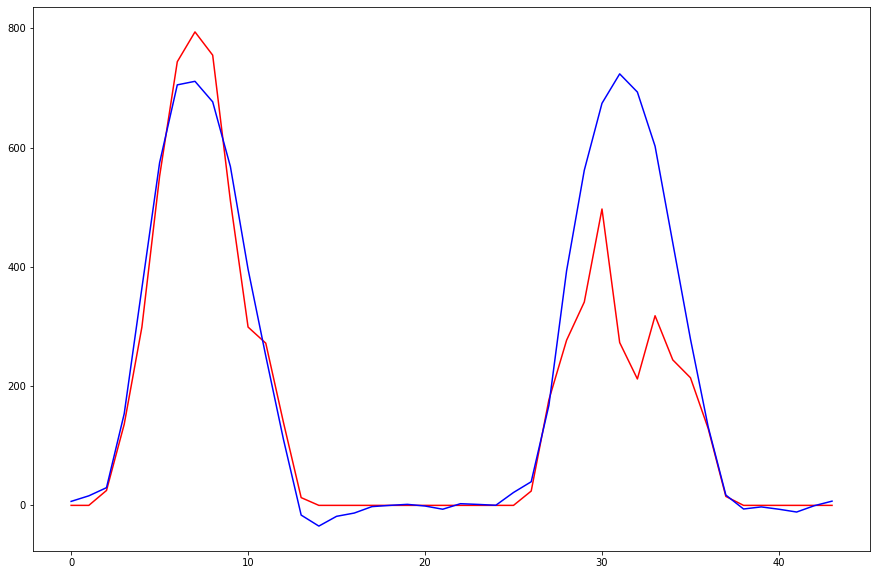

In [ ]:
plt.rcParams["figure.figsize"] = (15,10)
plt.plot(DF_test["GHI"].astype(float).tolist(), 'r')
plt.plot(df_r["GHI_forecast"].astype(float).tolist(), 'b')

Error analysis for DHI, DNI, GHI

In [ ]:
DHI = df.DHI.astype(float)
DHI_r = df_r.DHI_forecast.astype(float)
yhat_DHI = np.array(DHI_r['2020-01-01 06:00:00':'2020-01-01 17:00:00'])
y_DHI = np.array(DHI[17526:17538])
diff_DHI = y_DHI - yhat_DHI
#diff
mse_DHI = ((diff_DHI)**2).mean()
print('The Mean Squared Error of our forecasts is {}'.format(round(mse_DHI, 2)))
print('The Root Mean Squared Error of our forecasts is {}'.format(round(np.sqrt(mse_DHI), 4)))
mape_DHI = ((diff_DHI/y_DHI)*100).mean()
print('The MAPE of our forecast is {}'.format(round(mape_DHI, 4)))

The Mean Squared Error of our forecasts is 7218.52
The Root Mean Squared Error of our forecasts is 84.9618
The MAPE of our forecast is 12.1719


In [ ]:
GHI = df.GHI.astype(float)
GHI_r = df_r.GHI_forecast.astype(float)
yhat_GHI = np.array(GHI_r['2020-01-01 06:00:00':'2020-01-01 17:00:00'])
y_GHI = np.array(GHI[17526:17538])
diff_GHI = yhat_GHI - y_GHI
#yhat_GHI
#y_GHI
#diff_GHI
mse_GHI = ((diff_GHI)**2).mean()
#mse_GHI
print('The Mean Squared Error of our forecasts is {}'.format(round(mse_GHI, 2)))
print('The Root Mean Squared Error of our forecasts is {}'.format(round(np.sqrt(mse_GHI), 4)))
mape_GHI = ((diff_GHI/y_GHI)*100).mean()
print('The MAPE of our forecast is {}'.format(round(mape_GHI, 4)))


The Mean Squared Error of our forecasts is 54359.99
The Root Mean Squared Error of our forecasts is 233.1523
The MAPE of our forecast is 67.6576


In [ ]:
DNI = df.DNI.astype(float)
DNI_r = df_r.DNI_forecast.astype(float)
yhat_DNI = np.array(DNI_r['2020-01-01 06:00:00':'2020-01-01 17:00:00'])
y_DNI = np.array(DNI[17526:17538])
diff_DNI = yhat_DNI - y_DNI
#yhat_GHI
#y_GHI
#diff_GHI
mse_DNI = ((diff_DNI)**2).mean()
#mse_GHI
print('The Mean Squared Error of our forecasts is {}'.format(round(mse_DNI, 2)))
print('The Root Mean Squared Error of our forecasts is {}'.format(round(np.sqrt(mse_DNI), 4)))
mape_DNI = ((diff_DNI/y_DNI)*100).mean()
print('The MAPE of our forecast is {}'.format(round(mape_DNI, 4)))


The Mean Squared Error of our forecasts is 137051.34
The Root Mean Squared Error of our forecasts is 370.2045
The MAPE of our forecast is inf


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:13: RuntimeWarning: divide by zero encountered in true_divide
  del sys.path[0]
